In [21]:
import pandas as pd
import numpy as np
import altair as alt
from vega_datasets import data
import geopandas
from shapely.geometry import Point

In [2]:
df = pd.read_csv("data/language.csv")

In [3]:
df.head()

,wals_code,iso_code,glottocode,Name,latitude,longitude,genus,family,macroarea,countrycodes,...,137B M in Second Person Singular,136B M in First Person Singular,109B Other Roles of Applied Objects,10B Nasal Vowels in West Africa,25B Zero Marking of A and P Arguments,21B Exponence of Tense-Aspect-Mood Inflection,108B Productivity of the Antipassive Construction,130B Cultural Categories of Languages with Identity of 'Finger' and 'Hand',58B Number of Possessive Nouns,79B Suppletion in Imperatives and Hortatives
0,aab,NaN,NaN,Arapesh (Abu),-3.450000,142.950000,Kombio-Arapesh,Torricelli,NaN,PG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,aar,aiw,aari1239,Aari,6.000000,36.583333,South Omotic,Afro-Asiatic,Africa,ET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,aba,aau,abau1245,Abau,-4.000000,141.250000,Upper Sepik,Sepik,Papunesia,PG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,abb,shu,chad1249,Arabic (Abbéché Chad),13.833333,20.833333,Semitic,Afro-Asiatic,Africa,TD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,abd,abi,abid1235,Abidji,5.666667,-4.583333,Kwa,Niger-Congo,Africa,CI,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
df['macroarea'].value_counts()

Eurasia          660
Africa           607
Papunesia        558
North America    397
South America    257
Australia        177
Name: macroarea, dtype: int64

In [5]:
geometry = [Point(xy) for xy in zip(df['longitude'], df['latitude'])]

In [7]:
df = df.drop(['longitude', 'latitude'], axis=1)

In [9]:
crs = {'init': 'epsg:4326'}

In [11]:
gdf = geopandas.GeoDataFrame(df, crs=crs, geometry=geometry)

In [22]:
data_in  = alt.InlineData(values = gdf.to_json(), #geopandas to geojson string
                       # root object type is "FeatureCollection" but we need its features
                       format = alt.DataFormat(property='features',type='json'))

In [27]:
countries = alt.topo_feature(data.world_110m.url, 'countries')
projection = 'equirectangular'

In [31]:
points = alt.Chart(data_in).mark_geoshape(
).encode( 
    color='properties.macroarea:N', # DataFrame fields are accessible through a "properties" object 
    tooltip='properties.name:N'
).properties( 
    projection={"type":projection},
    width=500,
    height=300
)

In [32]:
base = alt.Chart(countries).mark_geoshape(
    fill='#666662',
    stroke='white'
).properties(
    width=300,
    height=180
).project(projection)

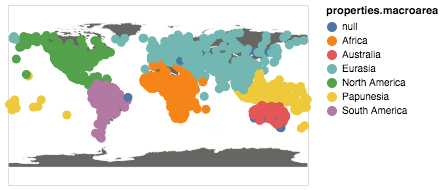

In [33]:
base + points